# 1. EDA

https://www.kaggle.com/datasets/manchunhui/us-election-2020-tweets?resource=download

# Import Libraries

In [0]:
!pip install emoji

You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-f6618294-58a6-435f-987f-ef21263f1d9f/bin/python -m pip install --upgrade pip' command.


In [0]:
from pyspark.sql.functions import lit, col, desc, to_date, length, count, when, hour, dayofweek, round, explode, lower, udf
from pyspark.sql.types import ArrayType, StringType
from pyspark.ml.feature import VectorAssembler, BucketedRandomProjectionLSH
from pyspark.sql.functions import col, count, desc, lit, coalesce, row_number
from pyspark.sql import functions as F
from pyspark.sql import SparkSession
from pyspark.sql.functions import round as spark_round
from pyspark.sql.window import Window
from pyspark.sql import DataFrame
from pyspark.sql.functions import floor
from pyspark.sql.functions import monotonically_increasing_id


import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.express as px
from sklearn.impute import KNNImputer
from functools import reduce

import re
import emoji

from pyspark.ml.feature import Tokenizer, StopWordsRemover, HashingTF, IDF, StringIndexer, CountVectorizer

In [0]:
# Initialize Spark session
spark = SparkSession.builder.appName("EDA").getOrCreate()

# Import and Concatenate CSVs

In [0]:
# File location and type
trump_file_location = "/FileStore/tables/hashtag_donaldtrump.csv"
biden_file_location = "/FileStore/tables/hashtag_joebiden.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# The applied options are for CSV files. For other file types, these will be ignored.
trump_df = (
    spark.read.format(file_type)
    .option("inferSchema", infer_schema)
    .option("header", first_row_is_header)
    .option("sep", delimiter)
    .option("quote", '"') # To handle commas correctly
    .option("escape", '"')
    .option("multiLine", "true")  # Allow fields to span multiple lines (helps with complex quoted fields)
    .option("mode", "PERMISSIVE") # Avoid failing on corrupt records
    .load(trump_file_location)
)

biden_df = (
    spark.read.format(file_type)
    .option("inferSchema", infer_schema)
    .option("header", first_row_is_header)
    .option("sep", delimiter)
    .option("quote", '"') # To handle commas correctly
    .option("escape", '"')
    .option("multiLine", "true")  # Allow fields to span multiple lines (helps with complex quoted fields)
    .option("mode", "PERMISSIVE") # Avoid failing on corrupt records
    .load(biden_file_location)
)

# Add 'candidate' column
trump_df = trump_df.withColumn("candidate", lit("trump"))
biden_df = biden_df.withColumn("candidate", lit("biden"))

# Union the datasets
combined_df = trump_df.unionByName(biden_df)

# Display result
display(combined_df)

created_at,tweet_id,tweet,likes,retweet_count,source,user_id,user_name,user_screen_name,user_description,user_join_date,user_followers_count,user_location,lat,long,city,country,continent,state,state_code,collected_at,candidate
2020-10-15T00:00:01.000+0000,1.3165292215572521E18,#Elecciones2020 | En #Florida: #JoeBiden dice que #DonaldTrump solo se preocupa por él mismo. El demócrata fue anfitrión de encuentros de electores en #PembrokePines y #Miramar. Clic AQUÍ ⬇️⬇️⬇️ ⠀ 🌐https://t.co/qhIWpIUXsT _ #ElSolLatino #yobrilloconelsol https://t.co/6FlCBWf1Mi,0.0,0.0,TweetDeck,3.60666534E8,El Sol Latino News,elsollatinonews,🌐 Noticias de interés para latinos de la costa este de #EEUU ⠀⏹️ Facebook e Instagram ⠀🏙️ Philadelphia: /elsollatinonewspaper ⠀🌅 Miami: /elsollatinonewsmiami,2011-08-23T15:33:45.000+0000,1860.0,"Philadelphia, PA / Miami, FL",25.77427,-80.19366,null,United States of America,North America,Florida,FL,2020-10-21T00:00:00.000+0000,trump
2020-10-15T00:00:01.000+0000,1.31652922274843034E18,"Usa 2020, Trump contro Facebook e Twitter: coprono Biden #donaldtrump https://t.co/6ceURhe1VP https://t.co/94jidLjoON",26.0,9.0,Social Mediaset,3.31617619E8,Tgcom24,MediasetTgcom24,Profilo ufficiale di Tgcom24: tutte le notizie sul sito https://t.co/sC5iMbymSN e sul canale 51 del digitale terrestre,2011-07-08T13:12:20.000+0000,1067661.0,null,null,null,null,null,null,null,null,2020-10-21T00:00:00.373+0000,trump
2020-10-15T00:00:02.000+0000,1.31652922809184691E18,"#Trump: As a student I used to hear for years, for ten years, I heard China! In 2019! And we have 1.5 and they don't know how many we have and I asked them how many do we have and they said 'sir we don't know.' But we have millions. Like 300 million. Um. What?",2.0,1.0,Twitter Web App,8436472.0,snarke,snarke,"Will mock for food! Freelance writer, blogger, commentator. Civics nerd. She/Her",2007-08-26T05:56:11.000+0000,1185.0,Portland,45.5202471,-122.6741949,Portland,United States of America,North America,Oregon,OR,2020-10-21T00:00:00.746+0000,trump
2020-10-15T00:00:02.000+0000,1.31652922747123712E18,2 hours since last tweet from #Trump! Maybe he is VERY busy. Tremendously busy.,0.0,0.0,Trumpytweeter,8.2835558920605696E17,Trumpytweeter,trumpytweeter,"If he doesn't tweet for some time, should we be worried?",2017-02-05T21:32:17.000+0000,32.0,null,null,null,null,null,null,null,null,2020-10-21T00:00:01.119+0000,trump
2020-10-15T00:00:08.000+0000,1.31652925230145126E18,You get a tie! And you get a tie! #Trump ‘s rally #Iowa https://t.co/jJalUUmh5D,4.0,3.0,Twitter for iPhone,4.7413798E7,Rana Abtar - رنا أبتر,Ranaabtar,"Washington Correspondent, Lebanese-American ,covering Capitol Hill &DC politics in Arabic for 15+yrs. Mom of identical twins. Beach, chocolate & gym lover.",2009-06-15T19:05:35.000+0000,5393.0,Washington DC,38.8949924,-77.0365581,Washington,United States of America,North America,District of Columbia,DC,2020-10-21T00:00:01.492+0000,trump
2020-10-15T00:00:17.000+0000,1.31652929105267507E18,@CLady62 Her 15 minutes were over long time ago. Omarosa never represented the black community! #TheReidOut She cried to #Trump begging for a job!,2.0,0.0,Twitter for Android,1.138416104E9,Farris Flagg,FarrisFlagg,#BidenHarris2020 #JoeBiden2020 #KamalaHarrisForVP #IStandWithEllen @KamalaHarris @JoeBiden #TeamJoe #KHive #BidenHarris2020ToSaveAmerica,2013-02-01T01:37:38.000+0000,2363.0,"Perris,California",33.7825194,-117.22864779999999,null,United States of America,North America,California,CA,2020-10-21T00:00:01.866+0000,trump
2020-10-15T00:00:17.000+0000,1.31652928994956902E18,@richardmarx Glad u got out of the house! DICK!!#trump 2020💪🏽🇺🇸🇺🇸,0.0,0.0,Twitter for iPhone,7.6740184103020954E17,Michael Wilson,wilsonfire9,null,2016-08-21T16:43:51.000+0000,75.0,"Powell, TN",null,null,null,null,null,null,null,2020-10-21T00:00:02.239+0000,trump
2020-10-15T00:00:18.000+0000,1.3165292934979625E18,@DeeviousDenise @realDonaldTrump @nypost There won’t be many of them. Unless you all have been voting m

In [0]:
combined_df.printSchema()

root
 |-- created_at: timestamp (nullable = true)
 |-- tweet_id: double (nullable = true)
 |-- tweet: string (nullable = true)
 |-- likes: double (nullable = true)
 |-- retweet_count: double (nullable = true)
 |-- source: string (nullable = true)
 |-- user_id: double (nullable = true)
 |-- user_name: string (nullable = true)
 |-- user_screen_name: string (nullable = true)
 |-- user_description: string (nullable = true)
 |-- user_join_date: timestamp (nullable = true)
 |-- user_followers_count: double (nullable = true)
 |-- user_location: string (nullable = true)
 |-- lat: double (nullable = true)
 |-- long: double (nullable = true)
 |-- city: string (nullable = true)
 |-- country: string (nullable = true)
 |-- continent: string (nullable = true)
 |-- state: string (nullable = true)
 |-- state_code: string (nullable = true)
 |-- collected_at: timestamp (nullable = true)
 |-- candidate: string (nullable = false)



# Sampling

In [0]:
total_rows = combined_df.count()

percent_df = (
    combined_df.groupBy("candidate")
    .agg(count("*").alias("count"))
    .withColumn("percentage", round(col("count") / total_rows * 100, 2))
    .orderBy("percentage", ascending=False)
)

percent_df.show()

+---------+------+----------+
|candidate| count|percentage|
+---------+------+----------+
|    trump|970919|     55.55|
|    biden|776886|     44.45|
+---------+------+----------+



In [0]:
df_trump = combined_df.filter(col("candidate") == "trump") \
                      .sample(withReplacement=False, fraction=0.25, seed=42)

df_biden = combined_df.filter(col("candidate") == "biden") \
                      .sample(withReplacement=False, fraction=0.25, seed=42)

df = df_trump.unionByName(df_biden)


In [0]:
sampled_rows = df.count()
print("Total sampled rows:", total_rows)

percent_df_sampled = (
    df.groupBy("candidate")
    .agg(count("*").alias("count"))
    .withColumn("percentage", round(col("count") / sampled_rows * 100, 2))
    .orderBy("percentage", ascending=False)
)

percent_df_sampled.show()


Total sampled rows: 1747805
+---------+------+----------+
|candidate| count|percentage|
+---------+------+----------+
|    trump|243582|     55.54|
|    biden|194992|     44.46|
+---------+------+----------+



# Remove Country Null Values

In [0]:
# Count total number of rows in the DataFrame
total = df.count()

# Create expressions to calculate % of missing values per column (rounded to 2 decimals)
exprs = [
    round((count(when(col(c).isNull(), c)) / total * 100), 2).alias(c)
    for c in df.columns
]

# Compute missing % for all columns in a single pass (1-row DataFrame)
missing_percent_row = df.select(exprs)

# Reshape the wide 1-row DataFrame into a long format - column and missing_percent
missing_df = missing_percent_row.selectExpr(
    f"stack({len(df.columns)}, " +
    ", ".join([f"'{c}', `{c}`" for c in df.columns]) +
    ") as (column, missing_percent)"
)

# Sort the results by missing percentage (descendent)
missing_df = missing_df.orderBy(col("missing_percent").desc())

# Display result
print("Combined Df - Missing Percentages")
display(missing_df)

Combined Df - Missing Percentages


column,missing_percent
city,76.38
state_code,68.86
state,66.79
country,54.45
continent,54.45
lat,54.2
long,54.2
user_location,30.25
user_description,10.47
source,0.09


In [0]:
# Create filtered DataFrame with non-null country
filtered_df = df.filter(col("country").isNotNull())

# Display result
display(filtered_df)

created_at,tweet_id,tweet,likes,retweet_count,source,user_id,user_name,user_screen_name,user_description,user_join_date,user_followers_count,user_location,lat,long,city,country,continent,state,state_code,collected_at,candidate
2020-10-15T00:00:18.000+0000,1.3165292934979625E18,@DeeviousDenise @realDonaldTrump @nypost There won’t be many of them. Unless you all have been voting more than once again. But God prevails. BO was the most corrupt President ever. Dark to light. Your lies are all coming through. They wouldn’t last forever. #Trump,0.0,0.0,Twitter for iPhone,9.0076107163142963E17,Stacey Gulledge 🇺🇸 Patriot ♥️ KAG 🙏 👮‍♀️♥️,sm_gulledge,"Patriot, Wife, “Shaken not Stirred” Mom of two extraordinary kids & labradoodle lover of “Honey Buns” Trust the Plan! Always Save Our Children!",2017-08-24T16:45:49.000+0000,766.0,"Ohio, USA",40.225356899999994,-82.6881395,null,United States of America,North America,Ohio,OH,2020-10-21T00:00:02.612+0000,trump
2020-10-15T00:00:42.000+0000,1.3165293935781847E18,#Ukraine @RealDonaldTrump impeachment #FactCheck ‘how’ often #Trump & @GOP lied!!! https://t.co/OFbVPBQs1s https://t.co/1n6bTkYOIW,0.0,2.0,Twitter Web App,3.43956175E8,Sebastian White,SebWrites,"Tortured, literary genius, well probably the first. Figured if I concentrate on the former, that the latter is 'bound' to occur... sooner or later!",2011-07-28T10:07:32.000+0000,2755.0,Edinburgh ~ Heart of Scotland!,55.9533456,-3.1883749,City of Edinburgh,United Kingdom,Europe,Scotland,SCT,2020-10-21T00:00:05.598+0000,trump
2020-10-15T00:01:23.000+0000,1.31652956936146944E18,"Comments on this? ""Do Democrats Understand how Ruthless China is?"" https://t.co/QevK00yhs3 #China #HunterBiden #JoeBiden #BidenHarris #BidenHarris2020 #TrumpPence2020 #Trump #realDonaldTrump #WTO #coronavirus #trade https://t.co/Wjm1hyTFNZ",0.0,0.0,Twitter Web App,1.01659277E8,John Ubaldi,ubaldireports,Just Facts... No Fiction on domestic and global political issues.,2010-01-04T04:34:39.000+0000,83.0,"Tampa, Florida",27.947759499999997,-82.458444,Tampa,United States of America,North America,Florida,FL,2020-10-21T00:00:10.076+0000,trump
2020-10-15T00:01:32.000+0000,1.3165296068962304E18,Ice Cube is teaming up to work with President Trump in developing The Platinum Plan. #2020election #AfricanAmericans #BlackAmerican #DiamondandSilk #DonaldTrump #featuredonWJLive #politics #race #TWJReports #USnews https://t.co/XFkzWFMbK0,14.0,6.0,dlvr.it,2.217181338E9,Conservative Tribune,conserv_tribune,"🇺🇸Commentary by The Western Journal Editor-in-Chief - @georgeupper Deputy Managing Editor, Assignment - @josh_manning Read more at @westjournalism",2013-11-27T04:58:32.000+0000,74657.0,United States,39.7837304,-100.4458825,null,United States,North America,null,null,2020-10-21T00:00:11.569+0000,trump
2020-10-15T00:01:44.000+0000,1.31652965396901888E18,Who does #trump owe 420 million dollars to? What are the terms? Who is #DonaldTrump beholden to? WE DEMAND TO KNOW! #TrumpIsANationalSecurityRisk #FollowTheMoney #TrumpTaxCheat #TrumpTaxFraud,1.0,0.0,Twitter Web App,1.611077E7,Therese Flanagan 🌊 🏳️‍🌈✊,thereseflanagan,I read; I write; I shoot photos. Chocolate is involved. There is also coffee and ale. #WarrenDem #TheResistance #BlueWave 🌊 #FreePress #BlackLivesMatter,2008-09-03T10:29:02.000+0000,8345.0,Chicago,41.875561600000005,-87.6244212,Chicago,United States of America,North America,Illinois,IL,2020-10-21T00:00:13.435+0000,trump
2020-10-15T00:01:48.000+0000,1.3165296726672343E18,"#JimJordan, #DevinNunes, #MattGaetz, #JohnCornyn, #BillBarr, #DonaldTrump & the rest who railed about it, should be indicted & go to jail for perpetuating a fraud against the #American people over the perfectly legal ""unmasking"" of General Flynn. They make me sick! #LockThemUp! https://t.co/m7XSsW58eh",0.0,0.0,Twitter Web App,2.162825861E9,Debra Bock,vapermom,"Married, disabled Mom w/2 GREAT sons. Medical & legal experience. Fights for the little guy, downtrodden & working class. ❤America, equality & humanity",

In [0]:
# Count total number of rows in the DataFrame
total_filtered = filtered_df.count()

# Create expressions to calculate % of missing values per column
exprs_filtered = [
    round((count(when(col(c).isNull(), c)) / total * 100), 2).alias(c)
    for c in filtered_df.columns
]

# Compute missing % for all columns
missing_percent_row_filtered = filtered_df.select(exprs)

# Reshape the wide 1-row DataFrame into a long format - column and missing_percent
missing_filtered_df = missing_percent_row_filtered.selectExpr(
    f"stack({len(filtered_df.columns)}, " +
    ", ".join([f"'{c}', `{c}`" for c in filtered_df.columns]) +
    ") as (column, missing_percent)"
)

# Sort the results by missing percentage
missing_filtered_df = missing_filtered_df.orderBy(col("missing_percent").desc())

# Display result
print("Filtered Df - Missing Percentages")
display(missing_filtered_df)

Filtered Df - Missing Percentages


column,missing_percent
city,21.93
state_code,14.41
state,12.34
user_description,2.5
source,0.01
created_at,0.0
tweet_id,0.0
tweet,0.0
likes,0.0
retweet_count,0.0


In [0]:
# Count rows in each DataFrame
total_rows = df.count()
filtered_rows = filtered_df.count()

# Calculate difference
dropped_rows = total_rows - filtered_rows
dropped_percentage = (dropped_rows / total_rows) * 100

# Print the results
print(f"Total rows in df: {total_rows}")
print(f"Rows after filtering (filtered_df): {filtered_rows}")
print(f"Rows dropped: {dropped_rows} ({dropped_percentage:.2f}%)")

Total rows in df: 438574
Rows after filtering (filtered_df): 199777
Rows dropped: 238797 (54.45%)


# Duplicates

## twee_id Duplicates

In [0]:
# Find tweet_ids with more than one occurrence
duplicate_ids = (
    filtered_df.groupBy("tweet_id")
    .agg(count("*").alias("count"))
    .filter("count > 1")
    .select("tweet_id")
)

# Filter original DataFrame to only rows with duplicated tweet_id
duplicate_ids_rows = filtered_df.join(
    duplicate_ids,
    on="tweet_id",
    how="inner"
)

In [0]:

# Show the duplicated 'tweet_id'
duplicate_ids_rows.orderBy("tweet_id").display()

tweet_id,created_at,tweet,likes,retweet_count,source,user_id,user_name,user_screen_name,user_description,user_join_date,user_followers_count,user_location,lat,long,city,country,continent,state,state_code,collected_at,candidate
1.3165331207457751E18,2020-10-15T00:15:30.000+0000,🥳 Donald #Trump vs. Joe #Biden Wahldebatte - #Schwäbisch https://t.co/iI5gFHVGJU via @YouTube,3.0,0.0,Twitter for iPhone,1.20737770466177024E18,Boris,borismtlr,🇪🇺🇩🇪🇷🇸 | Project Manager & Engineer | Still learning...🚀 #balkanborn #ThinkingInSystems | Nehmt euch mal nicht so ernst...,2019-12-18T19:10:59.000+0000,82.0,"Stuttgart, Deutschland",48.778448499999996,9.1800132,Stuttgart,Germany,Europe,Baden-Württemberg,BW,2020-10-21T00:01:45.993+0000,trump
1.3165331207457751E18,2020-10-15T00:15:30.000+0000,🥳 Donald #Trump vs. Joe #Biden Wahldebatte - #Schwäbisch https://t.co/iI5gFHVGJU via @YouTube,3.0,0.0,Twitter for iPhone,1.20737770466177024E18,Boris,borismtlr,🇪🇺🇩🇪🇷🇸 | Project Manager & Engineer | Still learning...🚀 #balkanborn #ThinkingInSystems | Nehmt euch mal nicht so ernst...,2019-12-18T19:10:59.000+0000,83.0,"Stuttgart, Deutschland",48.778448499999996,9.1800132,Stuttgart,Germany,Europe,Baden-Württemberg,BW,2020-10-21T00:02:12.563+0000,biden
1.31653505095614874E18,2020-10-15T00:23:10.000+0000,Early Vote ☑️ Vote like your life depends on it! #vote2020 #VoteHimOut2020 #VoteBiden #Biden #Trump,1.0,1.0,Twitter for Android,8.6720035027258573E17,Cole3_Survivor,Cole307489271,Greatest blessing being a #Mother. #CardiacArrestSurvivor & Heart Health Advocate. Love Music & Politics. As a Independent I see both sides #Blessed #VoteEarly,2017-05-24T02:07:30.000+0000,424.0,United States,39.7837304,-100.4458825,null,United States,North America,null,null,2020-10-21T00:02:34.138+0000,trump
1.31653505095614874E18,2020-10-15T00:23:10.000+0000,Early Vote ☑️ Vote like your life depends on it! #vote2020 #VoteHimOut2020 #VoteBiden #Biden #Trump,1.0,1.0,Twitter for Android,8.6720035027258573E17,Cole3_Survivor,Cole307489271,Greatest blessing being a #Mother. #CardiacArrestSurvivor & Heart Health Advocate. Love Music & Politics. As a Independent I see both sides #Blessed #VoteEarly,2017-05-24T02:07:30.000+0000,424.0,United States,39.7837304,-100.4458825,null,United States,North America,null,null,2020-10-21T00:03:24.541+0000,biden
1.31653948964545741E18,2020-10-15T00:40:49.000+0000,#politics Video links to ELECTION 2020 #BidenvsTrump #DonaldTrump #election2020 #JoeBiden #TrumpvsBiden https://t.co/gKQ2H2RFvF,0.0,0.0,Twitter Web App,1.54266844E8,Tom Gillispie,SptsGuy1,Tom Gillispie is writing a fifth book about auto racing. The first four had Dale Earnhardt Sr. (or his car) on the cover. EMAIL: tgilli52@gmail.com,2010-06-10T20:21:53.000+0000,2267.0,"Rural Hall, NC",35.6729639,-79.03929190000001,null,United States of America,North America,North Carolina,NC,2020-10-21T00:04:19.385+0000,trump
1.31653948964545741E18,2020-10-15T00:40:49.000+0000,#politics Video links to ELECTION 2020 #BidenvsTrump #DonaldTrump #election2020 #JoeBiden #TrumpvsBiden https://t.co/gKQ2H2RFvF,0.0,0.0,Twitter Web App,1.54266844E8,Tom Gillispie,SptsGuy1,Tom Gillispie is writing a fifth book about auto racing. The first four had Dale Earnhardt Sr. (or his car) on the cover. EMAIL: tgilli52@gmail.com,2010-06-10T20:21:53.000+0000,2267.0,"Rural Hall, NC",35.6729639,-79.03929190000001,null,United States of America,North America,North Carolina,NC,2020-10-21T00:05:58.854+0000,biden
1.31654466965683405E18,2020-10-15T01:01:24.000+0000,#Debates2020 Remember When #Trump Brought Up #HunterBiden #JoeBiden2020 Was Like How Dare You Talk About My Son Beau Biden He Served His Country and ... #Trump Is Like No I Was Talking About #Hunter #JoeBiden Is Like Oh That One! Give Him A Point #ChrisWallace,0.0,0.0,Twitter Web App,6.13926514E8,IP_Man,IP_ManLegacy,"Always Use Your Enemies Force Against Them, I Am REPLY DEBOOTED Until November 3rd Apparently! Retweets Are Welcome! Thanks",2012-06-21T01:41:33.000+0000,536.0,America,51.44770

In [0]:
# Group by all columns
duplicated_ids_df = (
    filtered_df.groupBy("tweet_id")
    .agg(count("*").alias("count"))
    .filter("count > 1")
)

# Count how many duplicated rows exist
num_duplicated_ids = duplicated_ids_df.count()
print(f"Number of duplicated 'tweed_id': {num_duplicated_ids}")

Number of duplicated 'tweed_id': 6541


In [0]:
filtered_df = filtered_df.dropDuplicates(["tweet_id"])

## Row Duplicates

In [0]:
# Group by all columns
duplicated_rows_df = (
    filtered_df.groupBy(filtered_df.columns)
    .agg(count("*").alias("count"))
    .filter("count > 1")
)

# Count how many duplicated rows exist
num_duplicated_rows = duplicated_rows_df.count()
print(f"Number of duplicated rows: {num_duplicated_rows}")

Number of duplicated rows: 0


# US Country Correction 

In [0]:
filtered_df = filtered_df.withColumn(
    "country",
    when(col("country").isin("United States", "United States of America"), "US")
    .otherwise(col("country"))
)

# Visualizations

## Overview

### Top Tweet Sources

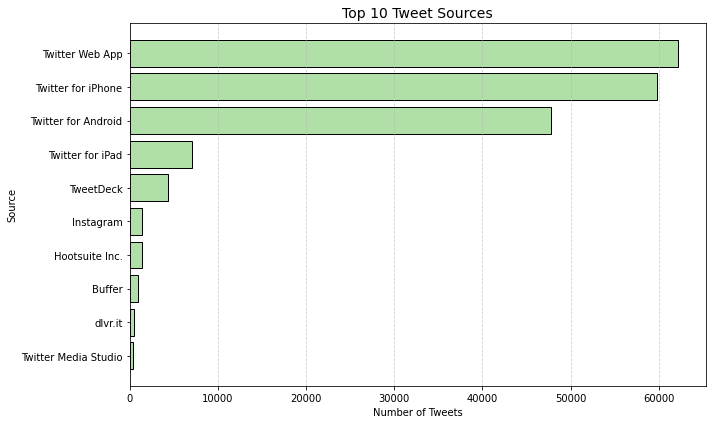

In [0]:
# Top sources
sources = filtered_df.groupBy("source").count().orderBy(desc("count")).limit(10)
sources_pd = sources.toPandas()

sources_pd = sources_pd.sort_values("count", ascending=True)

plt.figure(figsize=(10, 6))
plt.barh(sources_pd["source"], sources_pd["count"], color="#b0e0a8", edgecolor='black')

plt.title("Top 10 Tweet Sources", fontsize=14)
plt.xlabel("Number of Tweets")
plt.ylabel("Source")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Top Active Users

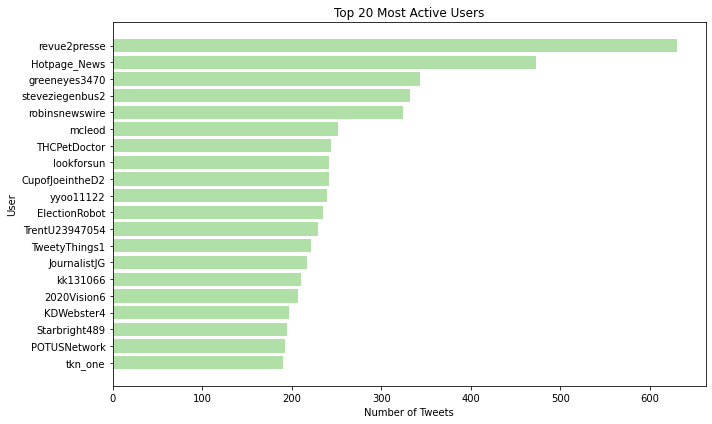

In [0]:
top_users = df.groupBy("user_screen_name") \
    .agg(count("*").alias("tweet_count")) \
    .orderBy(desc("tweet_count")) \
    .limit(20)

top_users_pd = top_users.toPandas()

plt.figure(figsize=(10, 6))
plt.barh(top_users_pd["user_screen_name"], top_users_pd["tweet_count"], color="#b0e0a8")
plt.title("Top 20 Most Active Users")
plt.xlabel("Number of Tweets")
plt.ylabel("User")
plt.gca().invert_yaxis() 
plt.tight_layout()
plt.show()

In [0]:
# Count number of tweets per user
user_tweet_counts = filtered_df.groupBy("user_screen_name").agg(count("*").alias("tweet_count"))

# Summary statistics
summary_stats = user_tweet_counts.select("tweet_count").describe()
summary_stats.show()

# Calculate quantiles 
quantiles = user_tweet_counts.approxQuantile("tweet_count", [0.25, 0.5, 0.75], 0.01)

print(f"25th percentile (Q1): {quantiles[0]}")
print(f"Median (Q2): {quantiles[1]}")
print(f"75th percentile (Q3): {quantiles[2]}")


+-------+------------------+
|summary|       tweet_count|
+-------+------------------+
|  count|             82626|
|   mean|2.3385011981700674|
| stddev|6.2919197131009055|
|    min|                 1|
|    max|               559|
+-------+------------------+

25th percentile (Q1): 1.0
Median (Q2): 1.0
75th percentile (Q3): 2.0


### Daily and Weeekly Activity

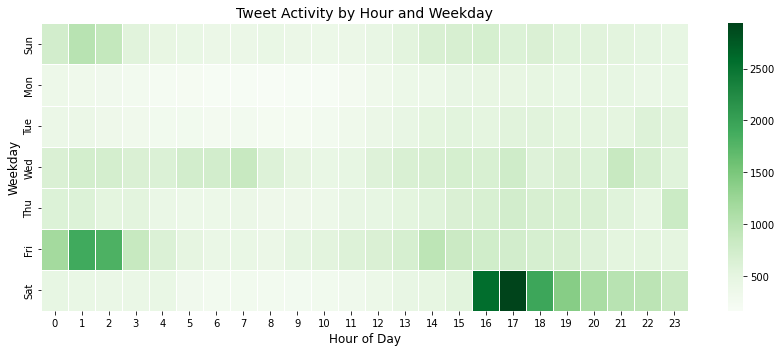

In [0]:
hour_weekdays = filtered_df.withColumn("hour", hour("created_at")) \
                           .withColumn("weekday", dayofweek("created_at"))

# Group by hour and weekday
tweets_by_time = hour_weekdays.groupBy("candidate", "weekday", "hour").count()
tweets_time_pd = tweets_by_time.toPandas()

# Map and order weekdays
weekday_labels = {1: 'Sun', 2: 'Mon', 3: 'Tue', 4: 'Wed', 5: 'Thu', 6: 'Fri', 7: 'Sat'}
tweets_time_pd["weekday"] = tweets_time_pd["weekday"].map(weekday_labels)
weekday_order = ['Sun', 'Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat']
tweets_time_pd["weekday"] = pd.Categorical(tweets_time_pd["weekday"], categories=weekday_order, ordered=True)


pivot_table = tweets_time_pd.pivot_table(index="weekday", columns="hour", values="count", fill_value=0)


plt.figure(figsize=(12, 5))
sns.heatmap(pivot_table, cmap="Greens", linewidths=0.5)

plt.title("Tweet Activity by Hour and Weekday", fontsize=14)
plt.xlabel("Hour of Day", fontsize=12)
plt.ylabel("Weekday", fontsize=12)
plt.tight_layout()
plt.show()


## Geography

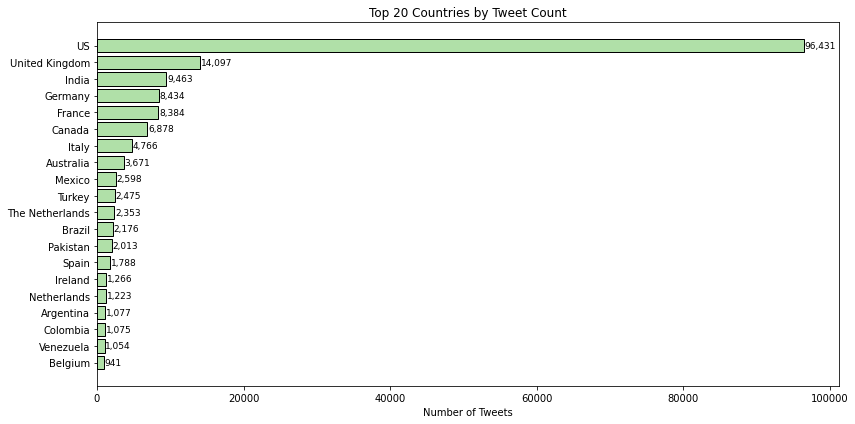

In [0]:
country_distribution = filtered_df.groupBy("country") \
    .count() \
    .orderBy(desc("count")) \
    .withColumnRenamed("count", "tweet_count") \
    .toPandas()

top_countries = country_distribution.head(20).copy()
top_countries["country"] = top_countries["country"].astype(str)
top_countries["tweet_count"] = top_countries["tweet_count"].astype(int)

plt.figure(figsize=(12, 6))
bars = plt.barh(top_countries["country"], top_countries["tweet_count"], color="#b0e0a8", edgecolor="black")

for bar in bars:
    width = bar.get_width()
    plt.text(width + 100, 
             bar.get_y() + bar.get_height() / 2,
             f"{width:,}",
             va='center', fontsize=9)

plt.title("Top 20 Countries by Tweet Count")
plt.xlabel("Number of Tweets")
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

### Geographic Correction

In [0]:
us_state_abbrev = {
    'Alabama': 'AL', 'Alaska': 'AK', 'Arizona': 'AZ', 'Arkansas': 'AR',
    'California': 'CA', 'Colorado': 'CO', 'Connecticut': 'CT', 'Delaware': 'DE',
    'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID',
    'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS',
    'Kentucky': 'KY', 'Louisiana': 'LA', 'Maine': 'ME', 'Maryland': 'MD',
    'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN', 'Mississippi': 'MS',
    'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV',
    'New Hampshire': 'NH', 'New Jersey': 'NJ', 'New Mexico': 'NM', 'New York': 'NY',
    'North Carolina': 'NC', 'North Dakota': 'ND', 'Ohio': 'OH', 'Oklahoma': 'OK',
    'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI', 'South Carolina': 'SC',
    'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT',
    'Vermont': 'VT', 'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV',
    'Wisconsin': 'WI', 'Wyoming': 'WY', 'District of Columbia': 'DC',
    'Puerto Rico': 'PR'
}


In [0]:
tweets_us = filtered_df.filter(filtered_df.country == "US") \
              .groupBy("state") \
              .count() \
              .withColumnRenamed("count", "tweet_count") \
              .toPandas()

tweets_us["state_code"] = tweets_us["state"].map(us_state_abbrev)

tweets_us

,state,tweet_count,state_code
0,Utah,432,UT
1,Hawaii,334,HI
2,Minnesota,854,MN
3,Ohio,2056,OH
4,Oregon,1326,OR
5,Arkansas,268,AR
6,Texas,7513,TX
7,North Dakota,209,ND
8,None,15013,NaN
9,Pennsylvania,2990,PA


In [0]:

fig_us = px.choropleth(
    tweets_us,
    locations="state_code",
    locationmode="USA-states",
    color="tweet_count",
    scope="usa",
    color_continuous_scale="Greens",
    title="Tweet Density by US State"
)
fig_us.show()

## Comparing candidates

In [0]:
color_map = {"trump": "#f4a6a6", "biden": "#a6c8f4"}

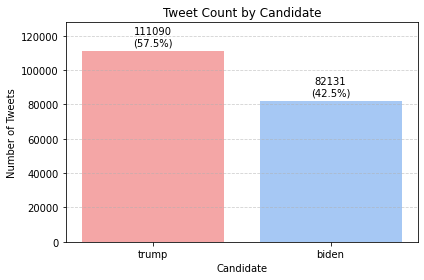

In [0]:
# Convert to Pandas for plotting
candidate_counts_pd = filtered_df.groupBy("candidate").count().toPandas()

# Calculate total and percentages
total = candidate_counts_pd["count"].sum()
candidate_counts_pd["percent"] = (candidate_counts_pd["count"] / total) * 100

# Define colors
colors = [color_map.get(candidate.lower(), "gray") for candidate in candidate_counts_pd["candidate"]]

# Plot
plt.figure(figsize=(6, 4))
bars = plt.bar(candidate_counts_pd["candidate"], candidate_counts_pd["count"], color=colors)

# Add values and percentages on bars
for bar, count, pct in zip(bars, candidate_counts_pd["count"], candidate_counts_pd["percent"]):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + total * 0.01,
             f"{count}\n({pct:.1f}%)", ha='center', va='bottom', fontsize=10)

# Final plot touches
plt.title("Tweet Count by Candidate")
plt.xlabel("Candidate")
plt.ylabel("Number of Tweets")
plt.ylim(0, max(candidate_counts_pd["count"]) * 1.15)
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

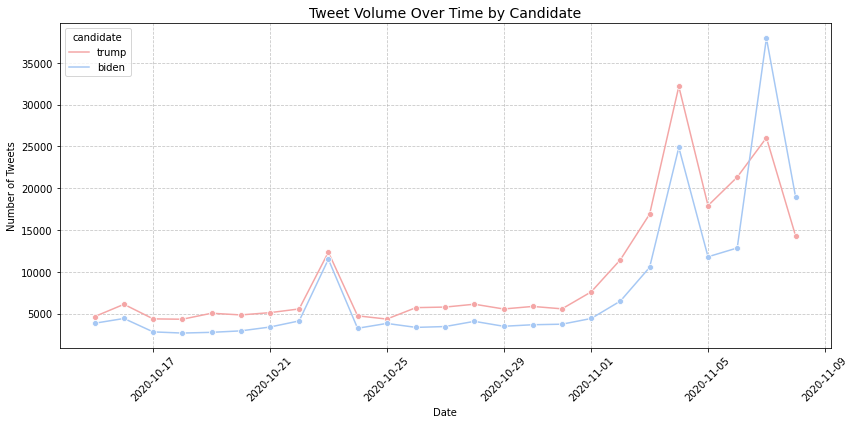

In [0]:
# Number of tweets over time by candidate
tweets_by_date_candidate = df.withColumn("date", to_date("created_at")) \
    .groupBy("date", "candidate") \
    .count() \
    .orderBy("date")

tweets_by_date_pd = tweets_by_date_candidate.toPandas()

plt.figure(figsize=(12, 6))
sns.lineplot(data=tweets_by_date_pd, x="date", y="count", hue="candidate", marker='o', palette=color_map)

plt.title("Tweet Volume Over Time by Candidate", fontsize=14)
plt.xlabel("Date")
plt.ylabel("Number of Tweets")
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


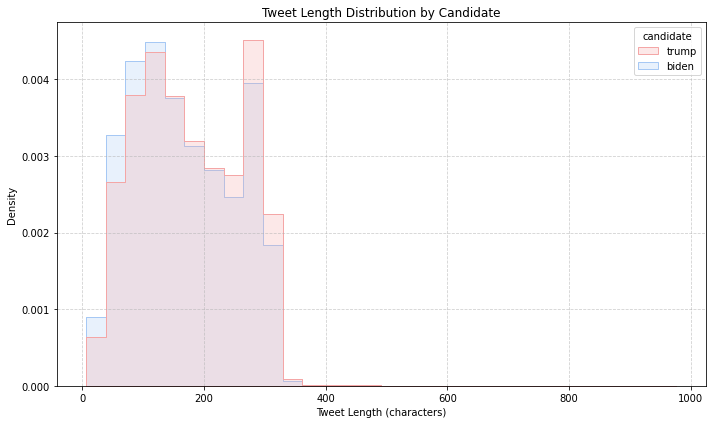

In [0]:
tweet_length_by_candidate = filtered_df.withColumn("tweet_length", length("tweet"))
tweet_length_by_candidate_pd = tweet_length_by_candidate.select("candidate", "tweet_length").toPandas()

plt.figure(figsize=(10, 6))
sns.histplot(data=tweet_length_by_candidate_pd, x="tweet_length", hue="candidate", bins=30, element="step", stat="density", common_norm=False,
             palette=color_map)

plt.title("Tweet Length Distribution by Candidate")
plt.xlabel("Tweet Length (characters)")
plt.ylabel("Density")
plt.grid(True, linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

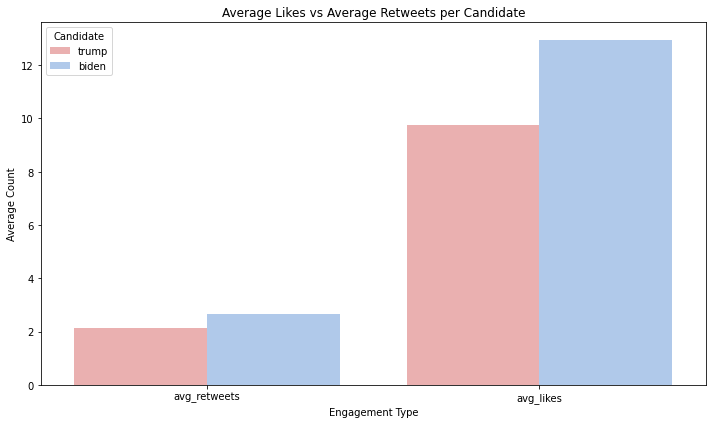

In [0]:
# Likes vs retweets comparison
engagement = filtered_df.groupBy("candidate").agg(
    {"likes": "avg", "retweet_count": "avg"}
).withColumnRenamed("avg(likes)", "avg_likes") \
 .withColumnRenamed("avg(retweet_count)", "avg_retweets")

engagement_pd = engagement.toPandas()

engagement_long = engagement_pd.melt(id_vars="candidate", 
                                     var_name="Engagement Type", 
                                     value_name="Average")

plt.figure(figsize=(10, 6))
sns.barplot(data=engagement_long, 
            x="Engagement Type", 
            y="Average", 
            hue="candidate", 
            palette=color_map)
plt.title("Average Likes vs Average Retweets per Candidate")
plt.ylabel("Average Count")
plt.xlabel("Engagement Type")
plt.legend(title="Candidate")
plt.tight_layout()
plt.show()

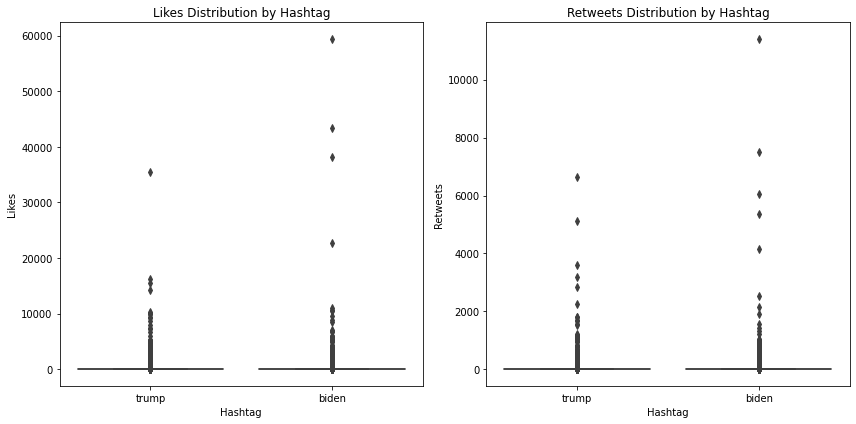

In [0]:
likes_retweets_pd = filtered_df.select("likes", "retweet_count", "candidate").toPandas()

# Plot
plt.figure(figsize=(12, 6))

# Likes
plt.subplot(1, 2, 1)
sns.boxplot(x="candidate", y="likes", data=likes_retweets_pd)
plt.title("Likes Distribution by Hashtag")
plt.xlabel("Hashtag")
plt.ylabel("Likes")

# Retweets
plt.subplot(1, 2, 2)
sns.boxplot(x="candidate", y="retweet_count", data=likes_retweets_pd)
plt.title("Retweets Distribution by Hashtag")
plt.xlabel("Hashtag")
plt.ylabel("Retweets")

plt.tight_layout()
plt.show()


In [0]:
# Count tweets per state per candidate
tweet_counts = filtered_df.filter(col("country") == "US") \
    .groupBy("state", "candidate") \
    .count() \
    .groupBy("state") \
    .pivot("candidate", ["biden", "trump"]) \
    .sum("count") \
    .fillna(0) \
    .toPandas()

tweet_counts["leading_candidate"] = tweet_counts.apply(
    lambda row: "biden" if row["biden"] > row["trump"] else "trump", axis=1
)

tweet_counts["state_code"] = tweet_counts["state"].map(us_state_abbrev)

tweet_counts["color_value"] = tweet_counts["leading_candidate"].map({"trump": 0, "biden": 1})

fig = px.choropleth(
    tweet_counts,
    locations="state_code",
    locationmode="USA-states",
    color="color_value",
    scope="usa",
    color_continuous_scale=[(0, color_map["trump"]), (1, color_map["biden"])],
    title="U.S. States by Tweet Majority: Biden vs Trump"
)

fig.update_coloraxes(showscale=False) 
fig.show()

## NLP Analysis

In [0]:
# Tokenize tweets
tokenizer = Tokenizer(inputCol="tweet", outputCol="words")
tokenized = tokenizer.transform(filtered_df)

# Remove stopwords
remover = StopWordsRemover(inputCol="words", outputCol="filtered")
filtered = remover.transform(tokenized)

In [0]:
# Explode tokens
words = filtered.select("candidate", explode("filtered").alias("word"))

# Lowercase and group
word_freq = words.withColumn("word", lower(col("word"))) \
    .groupBy("candidate", "word") \
    .count() \
    .orderBy("candidate", desc("count"))

# Top words 
top_words_pd = word_freq.filter(col("word").rlike("^[a-zA-Z0-9]{3,}$")).toPandas()

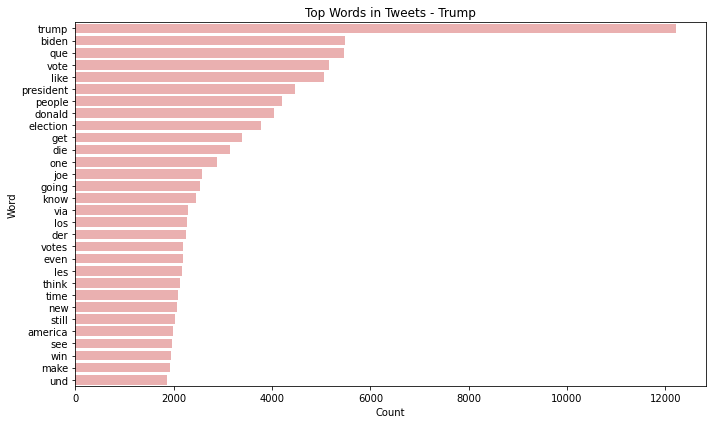

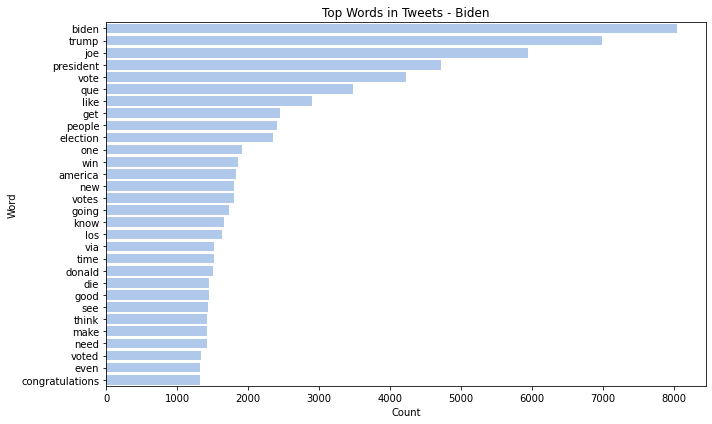

In [0]:
# Top 30 words for each candidate
for candidate in ["trump", "biden"]:
    subset = top_words_pd[top_words_pd["candidate"] == candidate].sort_values("count", ascending=False).head(30)

    plt.figure(figsize=(10, 6))
    sns.barplot(data=subset, x="count", y="word", color="#f4a6a6" if candidate == "trump" else "#a6c8f4")
    plt.title(f"Top Words in Tweets - {candidate.title()}")
    plt.xlabel("Count")
    plt.ylabel("Word")
    plt.tight_layout()
    plt.show()


In [0]:
# CountVectorizer with vocab
cv = CountVectorizer(inputCol="filtered", outputCol="rawFeatures", vocabSize=10000)
cv_model = cv.fit(filtered)
tf = cv_model.transform(filtered)

# IDF
idf = IDF(inputCol="rawFeatures", outputCol="features")
idf_model = idf.fit(tf)
tfidf_result = idf_model.transform(tf)

# Save vocab for decoding indices
vocab = cv_model.vocabulary

In [0]:
# Function to test if a word is clean 
def is_valid_word(word):
    return re.fullmatch(r"[a-zA-Z0-9]{3,}", word) is not None

# Extract top terms with filtering
def get_top_tfidf_words(row):
    indices = row.features.indices
    values = row.features.values
    sorted_items = sorted(zip(indices, values), key=lambda x: -x[1])
    
    # Filter and decode vocab
    clean_items = [(row.candidate, vocab[i], float(v)) for i, v in sorted_items if is_valid_word(vocab[i])]
    
    return clean_items[:10]  # top 10 only

In [0]:
top_tfidf_rdd = tfidf_result.select("candidate", "features").rdd.flatMap(get_top_tfidf_words)
top_tfidf_pd = pd.DataFrame(top_tfidf_rdd.collect(), columns=["candidate", "word", "tfidf"])

In [0]:
for candidate in ["trump", "biden"]:
    subset = top_tfidf_pd[top_tfidf_pd["candidate"] == candidate].sort_values("tfidf", ascending=False).head(15)

    fig = px.bar(
        subset,
        x="tfidf",
        y="word",
        orientation='h',
        title=f"Top TF-IDF Words – {candidate.title()}",
        color_discrete_sequence=[color_map[candidate]]
    )

    fig.update_layout(
        yaxis=dict(autorange="reversed"),
        xaxis_title="TF-IDF Score",
        yaxis_title="Words and emojis",
        title_x=0.5
    )

    fig.show()

In [0]:
# UDF to extract emojis from a string
def extract_emojis(text):
    return [c for c in text if c in emoji.EMOJI_DATA]

extract_emojis_udf = udf(extract_emojis, ArrayType(StringType()))

# Apply to tweet column
df_with_emojis = filtered_df.withColumn("emojis", extract_emojis_udf(col("tweet")))

In [0]:
emoji_counts = df_with_emojis.select("candidate", explode("emojis").alias("emoji")) \
    .groupBy("candidate", "emoji") \
    .count() \
    .orderBy("candidate", "count", ascending=[True, False])

# Convert to Pandas
emoji_counts_pd = emoji_counts.toPandas()

In [0]:
for candidate in ["trump", "biden"]:
    subset = emoji_counts_pd[emoji_counts_pd["candidate"] == candidate].head(10)

    fig = px.bar(
        subset,
        x="count",
        y="emoji",
        orientation="h",
        title=f"Top Emojis – {candidate.title()}",
        color_discrete_sequence=["#f4a6a6"] if candidate == "trump" else ["#a6c8f4"]
    )

    fig.update_layout(
        yaxis=dict(autorange="reversed"),
        xaxis_title="Count",
        yaxis_title="Emoji",
        title_x=0.5
    )

    fig.show()


# Export Dataframe

In [0]:
# Export the DataFrame as a Delta table
filtered_df.write.mode("overwrite") \
    .option("overwriteSchema", "true") \
    .format("delta") \
    .save("/dbfs/FileStore/tables/df_eda")

In [0]:
filtered_df.display()

created_at,tweet_id,tweet,likes,retweet_count,source,user_id,user_name,user_screen_name,user_description,user_join_date,user_followers_count,user_location,lat,long,city,country,continent,state,state_code,collected_at,candidate
2020-10-15T00:00:18.000+0000,1.3165292934979625E18,@DeeviousDenise @realDonaldTrump @nypost There won’t be many of them. Unless you all have been voting more than once again. But God prevails. BO was the most corrupt President ever. Dark to light. Your lies are all coming through. They wouldn’t last forever. #Trump,0.0,0.0,Twitter for iPhone,9.0076107163142963E17,Stacey Gulledge 🇺🇸 Patriot ♥️ KAG 🙏 👮‍♀️♥️,sm_gulledge,"Patriot, Wife, “Shaken not Stirred” Mom of two extraordinary kids & labradoodle lover of “Honey Buns” Trust the Plan! Always Save Our Children!",2017-08-24T16:45:49.000+0000,766.0,"Ohio, USA",40.225356899999994,-82.6881395,null,US,North America,Ohio,OH,2020-10-21T00:00:02.612+0000,trump
2020-10-15T00:02:00.000+0000,1.31652972462610432E18,#Trump is tearing up #Biden at the #TrumpRally over the #HunterBidenEmails,0.0,1.0,Twitter Web App,1.38870199E8,BIBLE MAN ✝️ Jesus' Rapture The Last Day John 6:40,acceptjesusnow,Jesus' #Rapture Prophecy The Last Day. This is the only correct explication of the Rapture ever published. https://t.co/qvS2JBo4l4,2010-04-30T21:28:28.000+0000,2589.0,"Hemet, California",33.7475203,-116.97196840000001,null,US,North America,California,CA,2020-10-21T00:00:13.981+0000,biden
2020-10-15T00:03:32.000+0000,1.31653010890827366E18,"#Trump: You don't mind if I go off script, right? This stuff is--you don't want to hear about Hunter and his millions of dollars. Where's Hunter? Is he here? Where's Hunter? Things have gone...awry.",3.0,1.0,Twitter Web App,8436472.0,snarke,snarke,"Will mock for food! Freelance writer, blogger, commentator. Civics nerd. She/Her",2007-08-26T05:56:11.000+0000,1185.0,Portland,45.5202471,-122.6741949,Portland,US,North America,Oregon,OR,2020-10-21T00:00:27.991+0000,trump
2020-10-15T00:08:13.000+0000,1.3165312889883607E18,@theprettybeaver @icecube What a load of rubbish. Black communities have had it hard for many years now. Not just the last 4 years. Are u winding me up. Most black films are minimum 20 years old and Tupac was screaming it from the 90s. So pleasehas everyone in the world lost their memory #icecube #trump,0.0,0.0,Twitter for iPhone,9.5485886113509798E17,pepp,pepp32948008,.....,2018-01-20T23:31:07.000+0000,3.0,"London, England",51.5073219,-0.1276474,London,United Kingdom,Europe,England,ENG,2020-10-21T00:01:00.461+0000,trump
2020-10-15T00:09:34.000+0000,1.31653162812707635E18,"@kylegriffin1 Actually, the President was impeached to cover the Lies by #JoeBiden , Obama and Hillary Clinton There, I fixed it for you #FakeNews #EnemyOfThePeople #mediahack",17.0,7.0,Twitter for Android,3.60076254E8,Eli 🇺🇸 🇻🇪 ❌,elianselmi,"Constitutional Conservative, Father, Latino, SciFi geek, #1A, #2A, Congressional Term Limits #COSProject #MAGA #KAG2020 *NO LISTS* Parler: @elianselmi",2011-08-22T17:04:26.000+0000,7012.0,"Bozeman, MT",45.679429299999995,-111.04404740000001,Bozeman,US,North America,Montana,MT,2020-10-21T00:01:18.191+0000,biden
2020-10-15T00:09:38.000+0000,1.31653164516032512E18,@AdamSchiff Impeached our president for something #JoeBiden did. We can’t let this stand,0.0,0.0,Twitter for iPhone,1.21868396594034688E18,FatTimGalante,FatTimGalante,Come at the King you best not miss. Omar Little—BMore MAGA2020,2020-01-18T23:58:26.000+0000,1738.0,"North Beach, MD",38.707868,-76.53148929999999,null,US,North America,Maryland,MD,2020-10-21T00:01:21.298+0000,biden
2020-10-15T00:11:15.000+0000,1.31653205006567834E18,I can't rap my head around why anyone would want #biden when he hasn't done anything productive in 47 years. I know Trump is extremely abrasive and never says the right thing but the country has prospered under him. 56% of Americans feel their life is better then 4 years ago. 1/2,0.0,0.0,Twitter for Android,7.5000094128636723E17,Booper,AZHustler8